In [2]:
import os
import re
import sys
from pathlib import Path

import h5py
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import skimage
import squidpy as sq
from skimage import io
from tqdm.notebook import tqdm, trange

sc.settings.verbosity = 3

import matplotlib
from matplotlib import cm, colors
from matplotlib.pyplot import rc_context

sc.set_figure_params(format="png")
import anndata as ad
import seaborn as sns
from PIL import Image
from scipy import ndimage
from skimage import exposure, measure, morphology
from sklearn.cluster import MiniBatchKMeans
import napari
import math


In [3]:
p_dir = (Path().cwd().parents[0]).absolute()
data_dir = p_dir / "data"

In [4]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import utils as my_utils

In [5]:
donors = [
    # "LN Donor A",
    # "LN Donor E",
    # "INT Donor B",
    # "INT Donor E",
    "TS Donor A",
    "TS Donor E",
]


# Read clustered data

In [6]:
adata_path = data_dir / "metadata" / f"combined_flowjo.h5ad"
adata = sc.read_h5ad(adata_path)

C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [7]:
type_dict = {
             'GC B-cells': 'B cells', 
             'DZ B-cells': 'B cells', 
             'LZ B-cells': 'B cells',
             'Cytotoxic T-cells': 'T cells', 
             'Exhausted T-cells': 'T cells', 
             'Follicular CD8+ T-cells': 'T cells', 
             'Helper T-cells': 'T cells', 
             'Follicular Helper T-cells': 'T cells', 
             'Regulatory T-cells': 'T cells',
}

In [8]:
adata.obs['New'] = (
    adata.obs["Phenotype"]
    .map(lambda x: type_dict.get(x, x))
    .astype("category")
)
adata.uns["New_colors"] = sc.pl.palettes.vega_20_scanpy[:len(np.unique(adata.obs['New']))]


In [9]:
adata_subset = adata[adata.obs.New.isin(['B cells', 'T cells'])]

# Read COL images

In [10]:
import matplotlib.patches as mpatches
from skimage.segmentation import mark_boundaries


def get_imgs(file_path, name):
    f = h5py.File(file_path, "r")
    imgs = f[name]
    labels = list(f[name].attrs["labels"])
    return imgs, labels


def contrast_streching(img):
    p2, p98 = np.percentile(img, (1, 99))
    return exposure.rescale_intensity(img, in_range=(p2, p98), out_range=(0, 255))

def get_img_size(roi_dict, size=1000):
    row_max = 0
    col_max = 0
    for k, v in roi_dict.items():
        row_max = max(row_max, v[0])
        col_max = max(col_max, v[1])
    return row_max + size, col_max + size

def get_img_subset(imgs, markers, labels):
    imgs_subset = []
    for marker in markers:
        idx = labels.index(marker)
        imgs_subset.append(imgs[idx])
    return np.stack(imgs_subset, axis=2)

In [11]:
# Format row, col
arrangement = {
    "LN Donor A": {
        1: [0, 1000],
        2: [0, 2000],
        3: [1000, 0],
        4: [1000, 1000],
        5: [1000, 2000],
        6: [1000, 3000],
        7: [2000, 0],
        8: [2000, 1000],
        9: [2000, 2000],
        10: [2000, 3000],
        11: [3000, 0],
        12: [3000, 1000],
        13: [3000, 2000],
        14: [3000, 3000],
        15: [4000, 1000],
        16: [4000, 2000],
    },
    "LN Donor E": {
        1: [1000, 0],
        2: [1000, 1000],
        3: [1000, 2000],
        4: [1000, 3000],
        5: [1000, 4000],
        6: [1000, 5000],
        7: [1000, 6000],
        8: [1000, 7000],
        9: [1000, 8000],
        10: [0, 0],
        11: [0, 1000],
        12: [0, 2000],
        13: [0, 3000],
        14: [0, 4000],
    },
    "INT Donor B": {
        1: [0, 0],
        2: [0, 1000],
        3: [1000, 0],
        4: [1000, 1000],
        5: [2000, 0],
        6: [2000, 1000],
        7: [2000, 2000],
        8: [2000, 3000],
        9: [3000, 0],
        10: [3000, 1000],
        11: [3000, 2000],
        12: [3000, 3000],
        13: [4000, 0],
        14: [4000, 1000],
        15: [4000, 2000],
        16: [4000, 3000],
        # 17: [5000, 0],
        # 18: [5000, 1000],
        # 19: [5000, 2000],
        # 20: [5000, 3000],
    },
    "INT Donor E": {
        1: [0, 0],
        2: [0, 1000],
        3: [0, 2000],
        4: [0, 3000],
        # 5: [0, 4000],
        6: [1000, 0],
        7: [1000, 1000],
        8: [1000, 2000],
        9: [1000, 3000],
        10: [1000, 4000],
        11: [2000, 3000],
        12: [2000, 4000],
        13: [3000, 3000],
        14: [3000, 4000],
        15: [4000, 3000],
        16: [4000, 4000],
    },
    "TS Donor A": {
        1: [0, 0],
        2: [0, 1000],
        3: [0, 2000],
        4: [0, 3000],
        5: [0, 4000],
        6: [0, 5000],
        7: [0, 6000],
        8: [1000, 0],
        9: [1000, 1000],
        10: [1000, 2000],
        11: [1000, 3000],
        12: [1000, 4000],
        13: [1000, 5000],
        14: [1000, 6000],
    },
    "TS Donor E": {
        1: [0, 0],
        2: [0, 1000],
        3: [0, 2000],
        4: [1000, 0],
        5: [1000, 1000],
        6: [1000, 2000],
        7: [2000, 0],
        8: [2000, 1000],
        9: [2000, 2000],
        10: [3000, 0],
        11: [3000, 1000],
        12: [3000, 2000],
        13: [4000, 0],
        14: [4000, 1000],
        15: [4000, 2000],
        16: [5000, 0],
        17: [5000, 1000],
        18: [5000, 2000],
    },
    "SP Donor A": {
        1: [0, 0],
        2: [0, 1000],
        3: [0, 2000],
        4: [0, 3000],
        5: [0, 4000],
        6: [1000, 0],
        7: [1000, 1000],
        8: [1000, 2000],
        9: [1000, 3000],
        10: [1000, 4000],
        11: [2000, 0],
        12: [2000, 1000],
        13: [2000, 2000],
        14: [2000, 3000],
        15: [2000, 4000],
        16: [3000, 0],
        17: [3000, 1000],
        18: [3000, 2000],
        19: [3000, 3000],
        20: [3000, 4000],
    },
}

In [12]:
size = 1000 
imgs_col = []

# Read COL1 images
for donor in donors:
    h5_data = p_dir / "data" / "h5_new" / f"{donor}.hdf5"
    
    # Create combined images
    y_max, x_max = get_img_size(arrangement[donor])
    img_col = np.zeros((y_max, x_max), dtype=np.uint8)

    ROIs = [i for i in range(1, 21)]
    for roi in tqdm(ROIs):
        if roi not in arrangement[donor].keys():
            continue

        # Read imgs
        imgs, labels = get_imgs(h5_data, str(roi))

        # Get multiplex image
        data = get_img_subset(imgs, ['COL1'], labels)

        # Insert Combined images
        y = arrangement[donor][roi][0]
        x = arrangement[donor][roi][1]
        img_col[y : y + size, x : x + size] = data[:1000,:1000].squeeze()

    img_col= contrast_streching(img_col)
    imgs_col.append(img_col)

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

# Plot COL with BT cells

In [13]:
import matplotlib 
from PIL import Image

def create_clustered_cell(mask, label2cell, my_cmap, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1],3), dtype=np.uint8)

    # for i, cells in tqdm(label2cell.items(), total=len(label2cell), leave=False):
    for i, cells in label2cell.items():
        rows, cols = np.where(np.isin(mask, cells))
        img[rows, cols, :] = my_cmap[int(i)]
    return img


def get_img_size(roi_dict, size=1000):
    row_max = 0
    col_max = 0
    for k, v in roi_dict.items():
        row_max = max(row_max, v[0])
        col_max = max(col_max, v[1])
    return row_max + size, col_max + size

# Read mask image
def get_masks(mask_folder):
    """
    Function to get all mask from mask forlder
    """
    # Read masks
    masks = {}

    for (dirpath, dirnames, filenames) in os.walk(mask_folder):
        for name in sorted(filenames):
            if "tif" in name:
                filename = os.path.join(dirpath, name)
                img = skimage.io.imread(filename)
                condition =  name.split(".")[0]
                masks[condition] = img
            else:
                continue
    return masks


In [14]:
masks = {}
for d in donors:
    masks[d] = get_masks(data_dir / "masks" / d)

In [15]:
colors = adata_subset.uns["New_colors"]
labels = adata_subset.obs.New.cat.categories.tolist()

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

In [16]:
imgs_BT = []
for d in donors:
    adata_donor = adata_subset[adata_subset.obs.Dataset == d, :]

    # Create combined images
    y_max, x_max = get_img_size(arrangement[d])
    img_combined = np.zeros((y_max, x_max, 3), dtype=np.uint8)

    for i in adata_donor.obs.ROI.unique():
        if i not in arrangement[d].keys():
            continue

        # Get dataset
        adata_s = adata_donor[adata_donor.obs.ROI == i, :]

        # Get mask
        mask = masks[d][str(int(i))]

        # Get label2cell dict
        label2cell = {}
        for j, l in enumerate(labels):
            cell_id = adata_s[adata_s.obs.New == l].obs.Cell_label.to_list()
            label2cell[j] = cell_id

        img = create_clustered_cell(mask, label2cell, colors_rgb)

        # Insert to combine image
        y = max(0, arrangement[d][i][0] - 1)
        x = max(0, arrangement[d][i][1] - 1)
        img_combined[y : y + size, x : x + size] = img

    imgs_BT.append(img_combined)

In [17]:
from matplotlib.colors import LinearSegmentedColormap

# get colormap
ncolors = 100
color_array = plt.get_cmap('Wistia')(range(ncolors))

# change alpha values
color_array[:,-1] = np.linspace(0.0,1.0, ncolors)

# create a colormap object
mycmap= LinearSegmentedColormap.from_list(name='mycmap', colors=color_array)


IndexError: list index out of range

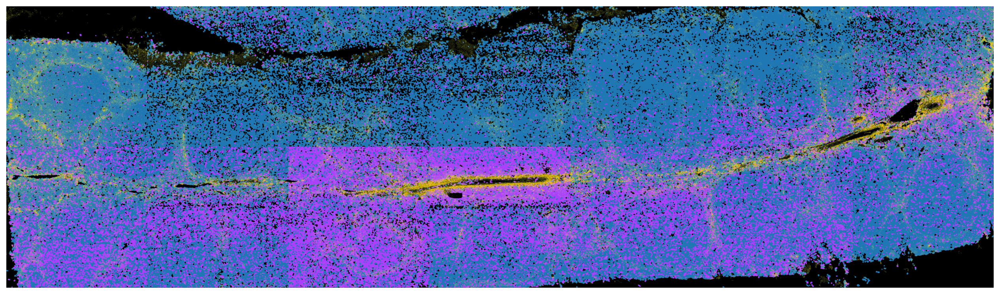

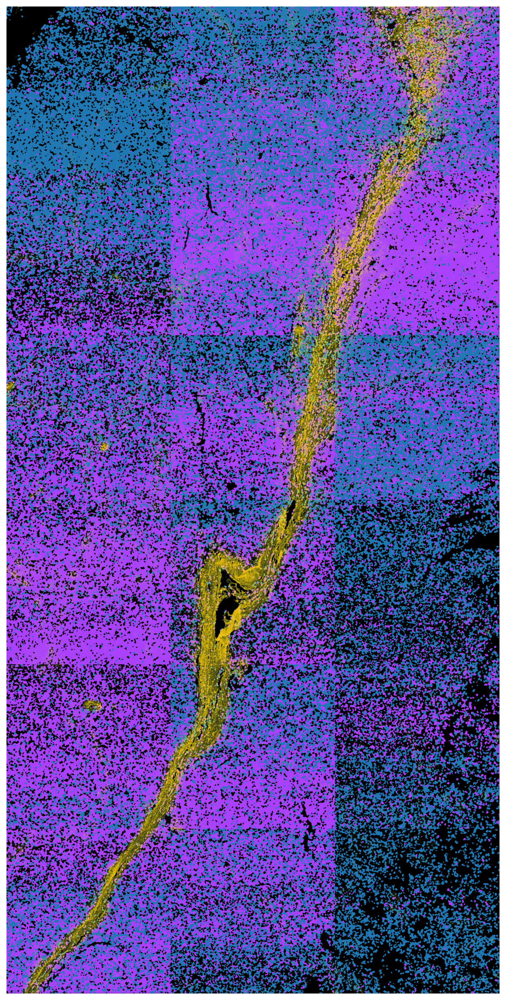

In [18]:
for i in range(6):
    img_col = imgs_col[i]
    img_bt = imgs_BT[i]
    
    fig, ax = plt.subplots(figsize=(20,20))
    ax.imshow(img_bt)
    ax.imshow(img_col, cmap=mycmap, alpha=0.9) 
    ax.axis('off')

# Plot with follicle region

In [19]:
def get_contour(mask: np.ndarray):
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        contours.append(measure.find_contours(mask == i, 0.8)[0])

    return contours

In [20]:
masks_follicle = get_masks(data_dir / 'masks_follicle')


IndexError: list index out of range

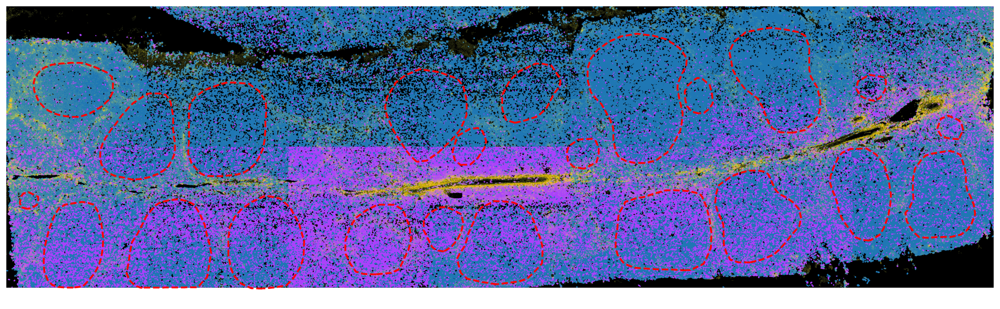

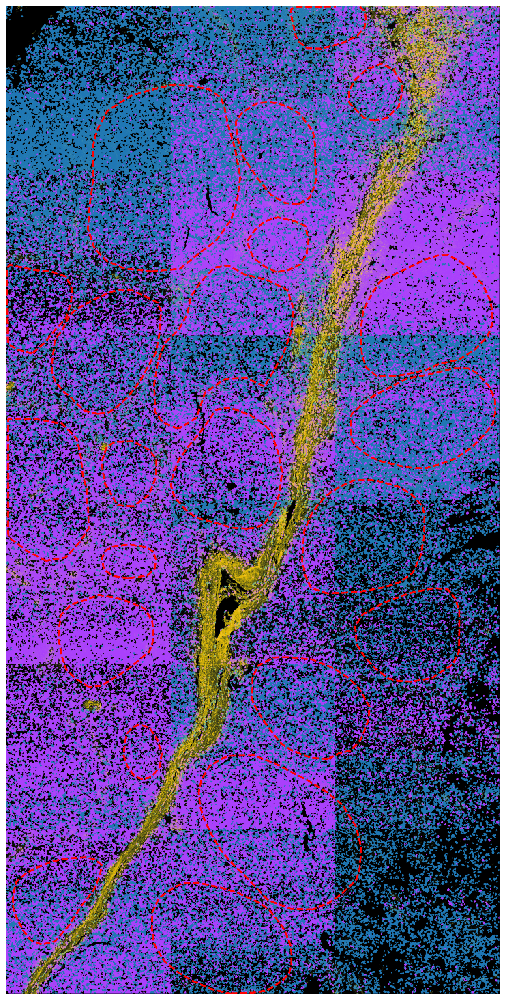

In [21]:
sns.set_style('white')

for i in range(6):
    img_col = imgs_col[i]
    img_bt = imgs_BT[i]
    mask = masks_follicle[donors[i]]
    
    contours = get_contour(mask)
   
    fig, ax = plt.subplots(figsize=(20,20))
    ax.imshow(img_bt)
    ax.imshow(img_col, cmap=mycmap, alpha=0.9) 
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color="red", linestyle='dashed')
    ax.axis("off")
    

# Analysis of follicle with COL markers

In [22]:
from skimage.measure import block_reduce, regionprops_table, regionprops

def mean_block(img, size):
    reduced = block_reduce(img_col, block_size=(size, size), func=np.mean)
    img_mean = np.repeat(reduced, size, axis=0)
    img_mean = np.repeat(img_mean, size, axis=1)
    return img_mean 

def get_prop_foll(mask, prop):
    props = regionprops_table(mask, properties=prop)
    
    return pd.DataFrame(props) 

In [26]:
masks_follicle = get_masks(data_dir / 'masks_follicle')
size = 10
thresh = 100

prop_list = ['label', 'area', 'centroid', 'bbox']
columns_name = ['Label', 'Area', 'row', 'col', 'min_row', 'min_col', 'max_row', 'max_col']

for i in range(len(donors)):
    
    # Read COL image and follicle mask
    img_col = imgs_col[i]
    mask = masks_follicle[donors[i]]
    print(img_col.shape)
    
    img_mean = mean_block(img_col, size)
    col_pos = img_mean > thresh
    
    # Get follcile mask centroid 
    df = get_prop_foll(mask, prop_list)
    df.columns = columns_name
    break

(2000, 7000)


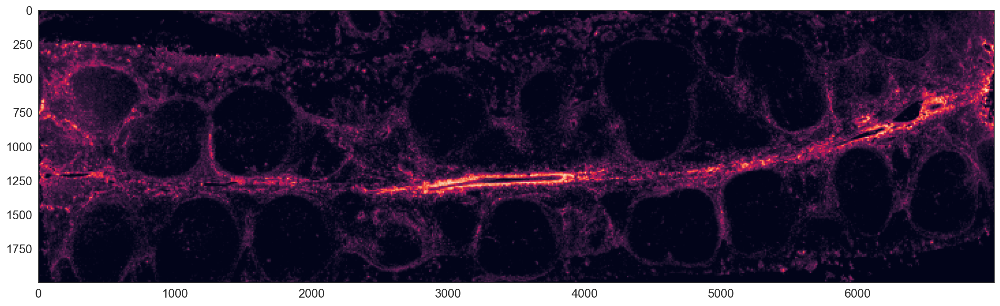

In [27]:
fig, ax = plt.subplots(figsize=(20,20))
ax.imshow(img_mean)

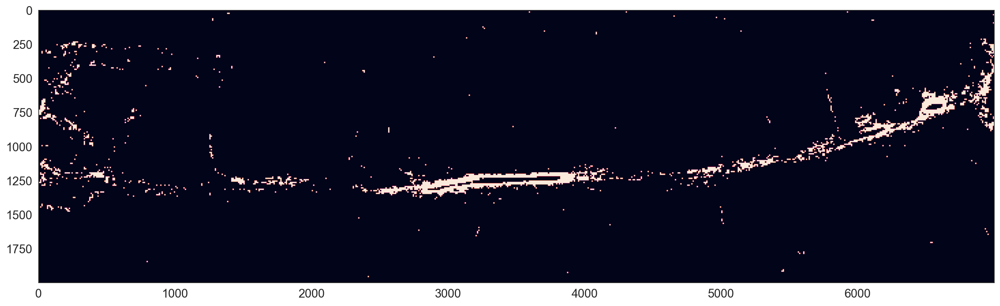

In [28]:
fig, ax = plt.subplots(figsize=(20,20))
ax.imshow(col_pos)

In [25]:
df

,Label,Area,row,col,min_row,min_col,max_row,max_col
0,1,172020,586.882025,471.017713,402,193,788,757
1,2,242563,948.911120,954.331238,620,664,1232,1196
2,3,11793,1382.058848,158.431442,1322,96,1441,226
3,4,209275,1701.286379,476.525476,1391,264,2000,687
4,5,298395,1718.824193,1163.433107,1371,852,2001,1452
5,6,315838,874.759953,1562.492445,541,1289,1208,1843
6,7,284205,1692.127127,1838.009915,1349,1574,2007,2112
7,8,185482,1663.907269,2638.657455,1410,2403,1906,2871
8,9,65492,1576.463858,3096.675166,1427,2958,1743,3239
9,10,274638,750.777882,2977.748946,447,2685,1107,3265
